In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

In [126]:
class SimpleNet(nn.Module):
    def __init__(self, in_features, hidden_size, out_dim):
        super().__init__()

        self.linear_1 = nn.Linear(in_features, hidden_size)
        self.hidden = nn.Linear(hidden_size, hidden_size)
        self.linear_2 = nn.Linear(hidden_size, out_dim)

    def forward(self, x):
        x = F.relu(self.linear_1(x))
        x = F.relu(self.hidden(x))
        x = self.linear_2(x)
        return x

In [4]:
x = torch.tensor([[x] for x in np.arange(0,10, 0.1)], dtype=torch.float)
y = torch.tensor([[np.sin(x)] for x in np.arange(0,10, 0.1)], dtype=torch.float)

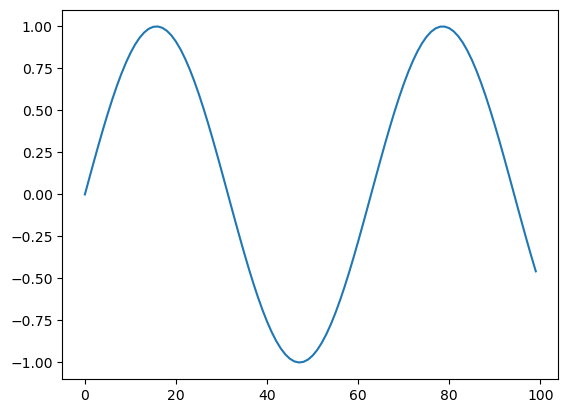

In [5]:
plt.plot(y)

In [136]:
model = SimpleNet(1, 100, 1)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-2)
criterion = nn.MSELoss()

In [137]:
outputs_list = []
for epoch in range(1000):
    # setting the gradients to 0
    optimizer.zero_grad()

    outputs = model(x)
    # compute the loss
    loss = criterion(y, outputs)
    # backward propagation for the loss
    loss.backward()
    # once gradients are passed "step using" optimizer
    optimizer.step()    

    outputs_list.append(outputs)

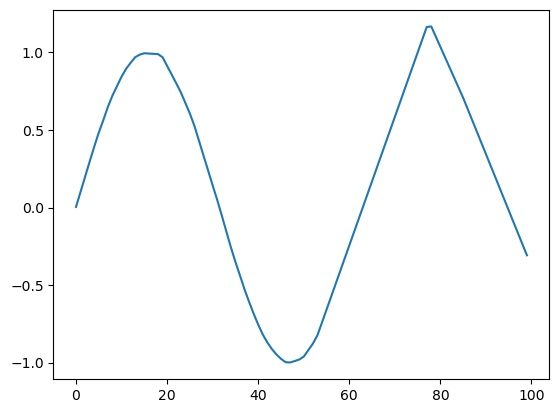

In [138]:
plt.plot(outputs.detach().numpy())

# DO NOT COPY THIS

Animation size has reached 20997677 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


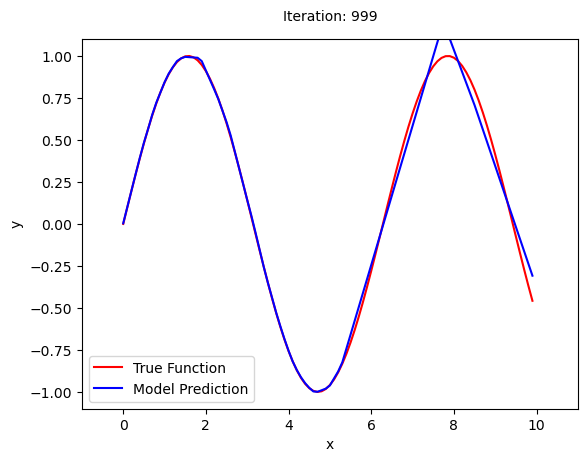

In [139]:
import matplotlib.animation as animation
# Create a figure and axis
fig, ax = plt.subplots()

# Set up the plot limits and labels
ax.set_xlim(-1, 11)
ax.set_ylim(-1.1, 1.1)

ax.set_xlabel('x')
ax.set_ylabel('y')

# True function line
true_line, = ax.plot(np.arange(0,10, 0.1), y, 'r-', label='True Function')

# Model prediction line (initially empty)
pred_line, = ax.plot([], [], 'b-', label='Model Prediction')

# Title
title = ax.text(0.5, 1.05, '', transform=ax.transAxes, ha='center')

# Add a legend
ax.legend()

# Initialization function for the animation
def init():
    pred_line.set_data([], [])
    title.set_text('Iteration: 0')
    return pred_line, title

# Update function for the animation
def update(frame):
    y_pred = outputs_list[frame].detach().numpy()
    pred_line.set_data(np.arange(0,10, 0.1), y_pred)
    title.set_text(f'Iteration: {frame}')
    return pred_line, title

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=1000, init_func=init, blit=True)


# Display the animation in the notebook (optional)
from IPython.display import HTML
HTML(ani.to_jshtml())


In [140]:
ani.save('model_learning.mp4', writer='ffmpeg')

# CODE A MODEL FROM SCRATCH

In [146]:
z = torch.tensor([0,-1,5])

In [147]:
torch.where(z > 0, z, 0)

tensor([0, 0, 5])

In [291]:
from typing import Any



class TensorModel(nn.Module):
    def __init__(self, in_features, hidden_size, out_dim):
        super().__init__()
        self.linear_1 = nn.Parameter(torch.rand((in_features, hidden_size)), requires_grad=True)
        self.bias_1 = nn.Parameter(torch.rand(hidden_size), requires_grad=True)
        self.linear_2 = nn.Parameter(torch.rand((hidden_size, hidden_size)), requires_grad=True)
        self.bias_2 = nn.Parameter(torch.rand(hidden_size), requires_grad=True)
        self.linear_3 = nn.Parameter(torch.rand((hidden_size, out_dim)), requires_grad=True)
        self.bias_3 = nn.Parameter(torch.rand(out_dim), requires_grad=True)
        
    # forward equivalent
    def forward(self, x):
        x = F.relu((x @ self.linear_1) + self.bias_1)
        x = F.relu((x @ self.linear_2) + self.bias_2)
        x = x @ self.linear_3 + self.bias_3
        return x

In [241]:
def loss_func(pred, actual):
    
    return torch.mean(((pred-actual) ** 2))

In [303]:
model = TensorModel(1, 200, 1)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-2)

In [243]:
y.shape[0]

100

In [307]:
outputs_list = []
for epoch in range(10000):
    # setting the gradients to 0
    optimizer.zero_grad()

    outputs = model(x)
    # compute the loss
    loss = criterion(y, outputs)
    # backward propagation for the loss
    loss.backward()
    # once gradients are passed "step using" optimizer
    optimizer.step()    

    outputs_list.append(outputs)

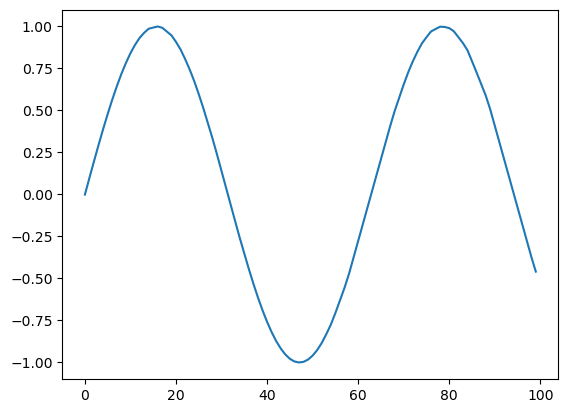

In [308]:
plt.plot(outputs.detach().numpy())